# Results for deconvolution experiments in all four datasets (simulations). 

The following notebook imports the processed results from the experiments of deconvolution using simulated bulks, and creates various analysis and visualizations.

Prior to running this notebook, make sure you have run the simualtions (shell scripts number 0, 1, 2, 3 and 4).

## Imports, paths and settings.

In [25]:
import os, re, glob, sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_ind
from numpy.linalg import norm
from scipy.stats import pearsonr
import matplotlib.lines as mlines
from sklearn.metrics import root_mean_squared_error
import matplotlib.collections as mcoll
from scipy.stats import ttest_ind, ttest_rel

sys.path.insert(1, "../../")
sys.path.insert(1, "../")
from src.helpers import compute_metrics, plot_controls, compute_cosine_similarity
from src.helpers import compute_average_expression, compute_metrics

baseline_transforms vairable let's us use the same notebook for the main reference analysis (the baseline transforms), and the references with the different gene removal.

If False, only process :'S-Cell All (Ctrl)', 'snRNA All (Ctrl)', 'snRNA', '-snRNA (-DEG Dataset)', '-DEG Intersection (3)', '-DEG Other Datasets', '-Random Genes'

If True, process: 'S-Cell All (Ctrl)', 'snRNA All (Ctrl)', 'snRNA', 'snRNA (-DEG)', 'PCA', 'PCA (-DEG)', 'scVILS', 'scVILS (-DEG)', 'scVIcond', 'scVIcond (-DEG)'

In [26]:
baseline_transforms = False

In [27]:
# =========================
# Settings
# =========================

datasets = ["ADP", "PBMC", "MSB", "MBC"]

dataset_markers = {"ADP": "o", "PBMC": "s", "MSB": "^", "MBC": "*"}

maps = {
    "dendritic cell": "Dendritic Cells",
    "endothelial cell": "Endothelial Cells",
    "immature NK T cell": "Immature NK T Cells",
    "monocyte": "Monocytes",
    "preadipocyte": "Preadipocytes",
    "T cell": "T Cells",
    "Endothelial cell": "Endothelial Cells",
    "T cell": "T Cells",
    "Macrophage": "Macrophages",
    "macrophage": "Macrophages",
    "Hepatocyte": "Hepatocytes",
    "Epithelial cell": "Epithelial Cells",
}

cell_type_palette = {
    "Dendritic Cells": "#FF7F0E",
    "Endothelial Cells": "#2CA02C",
    "Immature NK T Cells": "#9467bd",
    "Monocytes": "#8c564b",
    "Preadipocytes": "#e377c2",
    "T Cells": "#1f77b4",
    "Macrophages": "#d62728",
    "Hepatocytes": "#17becf",
    "Epithelial Cells": "#bcbd22",
}

if baseline_transforms:

    dataset_palette = {
        "MBC": "#1f77b4",
        "PBMC": "#ff7f0e",
        "ADP": "#2ca02c",
        "MSB": "burlywood",
    }

    control_colors = {
        "scRNA All (PosCtrl)": "#1f77b4",
        "snRNA All (NegCtrl)": "firebrick",
    }

    display_palette = {
        "scRNA All (PosCtrl)": "#1f77b4",
        "snRNA All (NegCtrl)": "firebrick",
        "snRNA": "rosybrown",
        "snRNA (-DEG)": "lightcoral",
        "PCA": "#2ca02c",
        "PCA (-DEG)": "#98df8a",
        "scVILS": "darkorange",
        "scVILS (-DEG)": "sandybrown",
        "scVIcond": "#9467bd",
        "scVIcond (-DEG)": "#c5b0d5",
    }
    transform_mapping = {
        "sc_raw": "scRNA All (PosCtrl)",
        "sn_raw": "snRNA All (NegCtrl)",
        "rawSN": "snRNA",
        "degSN": "snRNA (-DEG)",
        "pcaSN": "PCA",
        "degPCA_SN": "PCA (-DEG)",
        "scvi_LSshift_SN": "scVILS",
        "degScviLSshift_SN": "scVILS (-DEG)",
        "scviSN": "scVIcond",
        "degScviSN": "scVIcond (-DEG)",
    }
    display_order = [
        "scRNA All (PosCtrl)",
        "snRNA All (NegCtrl)",
        "snRNA",
        "snRNA (-DEG)",
        "PCA",
        "PCA (-DEG)",
        "scVILS",
        "scVILS (-DEG)",
        "scVIcond",
        "scVIcond (-DEG)",
    ]

else:
    # Palettes & transform names
    display_palette = {
        "-DEG Dataset": "lightcoral",
        "-DEG Other Datasets": "sandybrown",
        "-DEG Intersection": "tomato",
        "-Random Genes": "chocolate",
        "degIntAllSN": "snRNA All (-DEG Intersection)",
        
    }
    transform_mapping = {
        "degSN": "-DEG Dataset",
        "degOtherSN": "-DEG Other Datasets",
        "degIntSN": "-DEG Intersection",
        "degRandSN": "-Random Genes",
    }

    display_order = [
        "snRNA All (-DEG Intersection)",
        "-DEG Intersection",
        "-DEG Dataset",
        "-DEG Other Datasets",
        "-Random Genes",
    ]

    # Palettes & transform names for the mouse dataset
    keys_to_remove = ["-DEG Intersection", "-DEG Other Datasets", "-DEG Int. and DEG"]
    display_order_MSB = [item for item in display_order if item not in keys_to_remove]
    display_palette_MSB = {
        k: v for k, v in display_palette.items() if k not in keys_to_remove
    }
    transform_mapping_MSB = {
        k: v for k, v in transform_mapping.items() if k not in keys_to_remove
    }
base_dir = ".."

## Reading in the results

In [28]:
base_dir = ".."

results = {}
for ds in datasets:
    results_path = os.path.join(base_dir, "results", ds)
    results_file = os.path.join(results_path, f"results_{ds}.csv")
    if not os.path.exists(results_file):
        print(f"Missing results for {ds}: {results_file}. Skipping.")
        continue
    results[ds] = pd.read_csv(results_file)

    results[ds] = results[ds][results[ds].Transform.isin(transform_mapping.keys())]

results[ds]

,SampleID,CellType,PredProp,TrueProp,Transform,HoldoutCell
0,1,Epithelial cell,0.466945,0.762444,degIntSN,Endothelial cell
1,2,Epithelial cell,0.244851,0.139331,degIntSN,Endothelial cell
2,3,Epithelial cell,0.211270,0.058926,degIntSN,Endothelial cell
3,4,Epithelial cell,0.461410,0.743171,degIntSN,Endothelial cell
4,5,Epithelial cell,0.468119,0.757450,degIntSN,Endothelial cell
...,...,...,...,...,...,...
244995,996,T cell,0.060085,0.011430,degSN,T cell
244996,997,T cell,0.060596,0.048380,degSN,T cell
244997,998,T cell,0.103554,0.080400,degSN,T cell
244998,999,T cell,0.060120,0.138510,degSN,T cell


In [29]:
# Making sure cell type names are good (match)
for ds in datasets:
    results[ds].CellType = results[ds].CellType.replace(maps)
    results[ds].HoldoutCell = results[ds].HoldoutCell.replace(maps)

# We'll store the metrics for each scenario in these lists
all_cells_metrics = []
non_removed_metrics = []
removed_only_metrics = []

### We use 3 scenarios: all cells, onlt the removed cell, and only the non-removed cells.

In [30]:
for ds, df in results.items():

    print(ds)

    removed_df = df[df["HoldoutCell"].notna() & (df["CellType"] == df["HoldoutCell"])]

    pivot_pred = removed_df.pivot_table(
        index=["SampleID", "Transform"], columns="HoldoutCell", values="PredProp"
    )
    pivot_true = removed_df.pivot_table(
        index=["SampleID", "Transform"], columns="HoldoutCell", values="TrueProp"
    )

    # Find the *first* (sample,transform) row that has any NaNs:
    bad_rows = pivot_pred[pivot_pred.isna().any(axis=1)]
    if not bad_rows.empty:
        idx = bad_rows.index[0]
        print("[QC] First problematic row:", idx)
        print("[QC] pred row:\n", pivot_pred.loc[idx])
        print("[QC] true row:\n", pivot_true.loc[idx])
    else:
        print("[QC] No NaNs found in pivot_pred—every value is finite!")

    # SampleID is treated as string for grouping.
    df["SampleID"] = df["SampleID"].astype(str)

    # ---------------------------
    # Scenario 1: All Cells
    # ---------------------------
    print("Scenario 1")
    # IMPORTANT: we use dropna=False so that groups with NaN in HoldoutCell (controls) are included.
    groups = df.groupby(["SampleID", "Transform", "HoldoutCell"], dropna=False)
    for name, group in groups:
        sample_id, transform, holdout_cell = name
        y_pred = group["PredProp"].values
        y_true = group["TrueProp"].values
        pearson_val, _ = pearsonr(y_true, y_pred)

        rmse_val = root_mean_squared_error(y_true, y_pred)
        all_cells_metrics.append(
            {
                "Dataset": ds,
                "SampleID": sample_id,
                "Transform": transform,
                # If holdout_cell is NaN, record it as "None"
                "RemovedCell": holdout_cell if pd.notna(holdout_cell) else "None",
                "RMSE_All": rmse_val,
                "Pearson_All": pearson_val,
            }
        )

    print("Scenario 2")

    # --------------------------
    # Scenario 2: All Cells Except Held Out Cell
    # ---------------------------
    # Process experiments where a cell was held out.
    holdout_df = df[df["HoldoutCell"].notna()].copy()
    groups_holdout = holdout_df.groupby(["SampleID", "Transform", "HoldoutCell"])
    for name, group in groups_holdout:
        sample_id, transform, holdout_cell = name
        # Remove rows corresponding to the removed cell.
        filtered_group = group[group["CellType"] != holdout_cell]
        if filtered_group.empty:
            continue
        y_pred = filtered_group["PredProp"].values
        y_true = filtered_group["TrueProp"].values
        pearson_val, _ = pearsonr(y_true, y_pred)

        rmse_val = root_mean_squared_error(y_true, y_pred)
        non_removed_metrics.append(
            {
                "Dataset": ds,
                "SampleID": sample_id,
                "Transform": transform,
                "RemovedCell": holdout_cell,
                "RMSE_NonRemoved": rmse_val,
                "Pearson_NonRemoved": pearson_val,
            }
        )

    # Process controls (where no cell was held out).
    control_df = df[df["HoldoutCell"].isna()].copy()
    groups_control = control_df.groupby(["SampleID", "Transform"], dropna=False)
    for name, group in groups_control:
        sample_id, transform = name
        y_pred = group["PredProp"].values
        y_true = group["TrueProp"].values
        pearson_val, _ = pearsonr(y_true, y_pred)

        rmse_val = root_mean_squared_error(y_true, y_pred)
        non_removed_metrics.append(
            {
                "Dataset": ds,
                "SampleID": sample_id,
                "Transform": transform,
                "RemovedCell": "None",
                "RMSE_NonRemoved": rmse_val,
                "Pearson_NonRemoved": pearson_val,
            }
        )

    print("Scenario 3")

    # ---------------------------
    # Scenario 3: Removed Cell Only
    # ---------------------------
    # Only consider experiments where a cell was held out and keep only the row
    # where the predicted cell type equals the held-out cell.
    removed_df = df[df["HoldoutCell"].notna()].copy()
    removed_df = removed_df[removed_df["CellType"] == removed_df["HoldoutCell"]]

    # Pivot so that each row (SampleID, Transform) has columns corresponding to the removed cell.
    pivot_pred = removed_df.pivot_table(
        index=["SampleID", "Transform"], columns="HoldoutCell", values="PredProp"
    )
    pivot_true = removed_df.pivot_table(
        index=["SampleID", "Transform"], columns="HoldoutCell", values="TrueProp"
    )

    for idx in pivot_pred.index:
        sample_id, transform = idx
        common_cols = pivot_pred.columns.intersection(pivot_true.columns)
        pred_vec = pivot_pred.loc[idx, common_cols].values
        true_vec = pivot_true.loc[idx, common_cols].values

        if len(pred_vec) == 0:
            continue
        else:
            pearson_val, _ = pearsonr(true_vec, pred_vec)

        rmse_val = root_mean_squared_error(true_vec, pred_vec)
        removed_cells = ",".join(common_cols.tolist())
        removed_only_metrics.append(
            {
                "Dataset": ds,
                "SampleID": sample_id,
                "Transform": transform,
                "RemovedCell": removed_cells,
                "RMSE_RemovedOnly": rmse_val,
                "Pearson_RemovedOnly": pearson_val,
            }
        )

ADP
[QC] No NaNs found in pivot_pred—every value is finite!
Scenario 1
Scenario 2
Scenario 3
PBMC
[QC] No NaNs found in pivot_pred—every value is finite!
Scenario 1
Scenario 2
Scenario 3
MSB
[QC] No NaNs found in pivot_pred—every value is finite!
Scenario 1
Scenario 2
Scenario 3
MBC
[QC] No NaNs found in pivot_pred—every value is finite!
Scenario 1
Scenario 2
Scenario 3


In [31]:
# Convert the lists of metrics to DataFrames
all_cells_df = pd.DataFrame(all_cells_metrics)
non_removed_df = pd.DataFrame(non_removed_metrics)
removed_only_df = pd.DataFrame(removed_only_metrics)

In [32]:
# First, build the union of cell types across all datasets (from both CellType and HoldoutCell)
all_cell_types = set()
for ds in datasets:
    df = results[ds]
    # Add all non-null cell types from both columns
    all_cell_types.update(df["CellType"].dropna().unique())
    all_cell_types.update(df["HoldoutCell"].dropna().unique())
all_cell_types = sorted(
    list(all_cell_types)
)  # sort alphabetically or customize as needed

# Generate a global palette
n_cell_types = len(all_cell_types)
global_colors = sns.color_palette("colorblind", n_colors=n_cell_types)
global_cell_palette = dict(zip(all_cell_types, global_colors))

# Now, for each dataset, build a cell type order (hue_order) and corresponding palette dictionary.
dataset_cell_info = {}
for ds in datasets:
    df = results[ds]
    # Get unique cell types in the dataset (from the 'CellType' column, for plotting)
    ds_cell_types = sorted(list(df["CellType"].dropna().unique()))
    # Build the dataset-specific palette: pick the colors from the global palette.
    ds_palette = {ct: global_cell_palette[ct] for ct in ds_cell_types}
    dataset_cell_info[ds] = {"cell_order": ds_cell_types, "palette": ds_palette}

In [33]:
if baseline_transforms:
    # Create a copy and map the display name.
    df = all_cells_df.copy()
    df["DisplayTransform"] = df["Transform"].map(transform_mapping)

    # Filter for only the two controls.
    controls = ["scRNA All (PosCtrl)", "snRNA All (NegCtrl)"]
    df_controls = df[df["DisplayTransform"].isin(controls)].copy()

    plot_controls(
        string_title="RMSE",
        string_column="RMSE_All",
        string_ylabel="RMSE",
        df_controls=df_controls,
        control_colors=control_colors,
        dataset_palette=dataset_palette,
    )

    plot_controls(
        string_title="Pearson Correlation",
        string_column="Pearson_All",
        string_ylabel="Pearson r",
        df_controls=df_controls,
        control_colors=control_colors,
        dataset_palette=dataset_palette,
    )

In [34]:
def plot_by_dataset(
    string_title="RMSE",
    string_column="RMSE",
    string_ylabel="RMSE",
    df_controls=None,
    dataset_order=None,
):

    # Map reference types to consistent colors
    ref_color_map = {
        "scRNA All (PosCtrl)": "#1f77b4",
        "snRNA All (NegCtrl)": "firebrick",
    }
    if string_column == "RMSE_All":
        plt.figure(figsize=(30, 15))
    else:
        plt.figure(figsize=(30, 13))

    ax = sns.boxplot(
        x="Dataset",
        y=string_column,
        hue="DisplayTransform",
        data=df_controls,
        palette=ref_color_map,
        linewidth=5,
        fliersize=10,
        order=dataset_order,
        hue_order=["scRNA All (PosCtrl)", "snRNA All (NegCtrl)"],
    )
    plt.xlabel("Dataset", fontsize=48, fontweight="bold")
    plt.ylabel(string_ylabel, fontsize=48, fontweight="bold")
    plt.xticks(rotation=0, fontsize=40)
    if string_column == "RMSE_All":
        plt.title(f"{string_title}", fontsize=62, fontweight="bold")
        plt.yticks([0, 0.1, 0.2, 0.3, 0.4], fontsize=32)
        handles, _ = ax.get_legend_handles_labels()
        new_labels = ["scRNA-seq Reference", "snRNA-seq Reference"]
        ax.legend(
            handles=handles,
            labels=new_labels,
            title="Reference Type",
            title_fontproperties={"weight": "bold", "size": 42},
            fontsize=35,
            bbox_to_anchor=(1, -0.15),
        )
    else:
        plt.title(
            f"Deconvolution Performance by Dataset:\n{string_title}",
            fontsize=62,
            fontweight="bold",
        )
        plt.yticks([-1, -0.5, 0, 0.5, 1], fontsize=32)
        ax.legend_.remove()
    plt.tight_layout()
    plt.show()

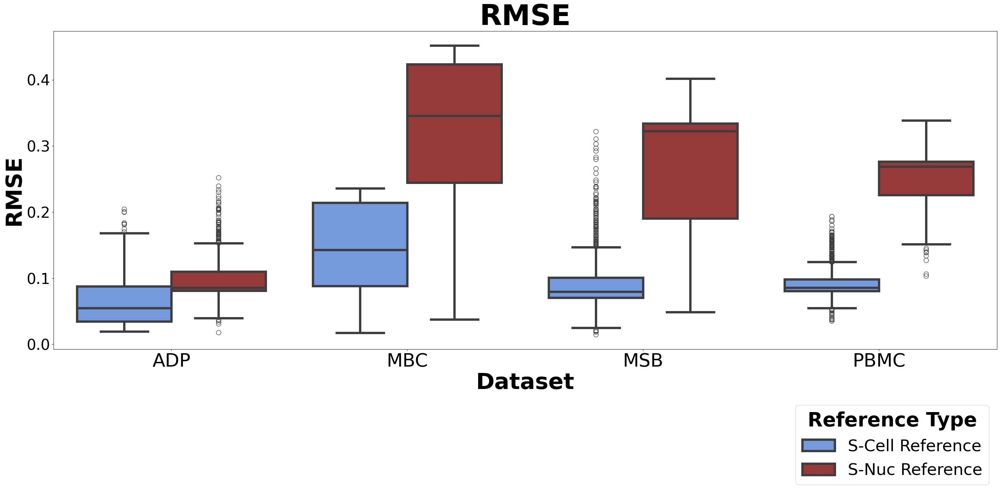

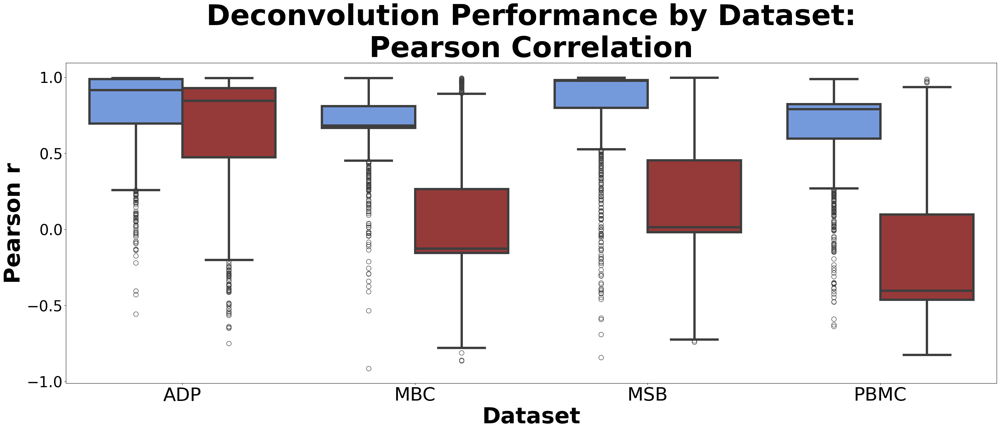

In [35]:
plot_by_dataset(
    string_title="RMSE",
    string_column="RMSE_All",
    string_ylabel="RMSE",
    df_controls=df_controls,
    dataset_order=["ADP", "PBMC", "MBC", "MSB"],
)

plot_by_dataset(
    string_title="Pearson Correlation",
    string_column="Pearson_All",
    string_ylabel="Pearson r",
    df_controls=df_controls,
    dataset_order=["ADP", "PBMC", "MBC", "MSB"],
)

## Statistical Tests for Controls 

In [36]:
if baseline_transforms:
    sc_values = df_controls[df_controls["DisplayTransform"] == "scRNA All (PosCtrl)"][
        "Pearson_All"
    ]
    sn_values = df_controls[df_controls["DisplayTransform"] == "snRNA All (NegCtrl)"][
        "Pearson_All"
    ]

    # If the samples are independent:
    stat, p_value = ttest_ind(sc_values, sn_values, nan_policy="omit")
    print("Independent t-test for Pearson:")
    print(f"Statistic: {stat:.4f}, p-value: {p_value:.6f}")

    sc_values = df_controls[df_controls["DisplayTransform"] == "scRNA All (PosCtrl)"][
        "RMSE_All"
    ]
    sn_values = df_controls[df_controls["DisplayTransform"] == "snRNA All (NegCtrl)"][
        "RMSE_All"
    ]

    # If the samples are independent:
    stat, p_value = ttest_ind(sc_values, sn_values, nan_policy="omit")
    print("Independent t-test for RMSE:")
    print(f"Statistic: {stat:.4f}, p-value: {p_value:.6f}")

In [37]:
# Only run if baseline_transforms is True
if baseline_transforms:
    # collect unique dataset names
    datasets = df_controls["Dataset"].unique()

    for ds in datasets:
        sub = df_controls[df_controls["Dataset"] == ds]

        # Pearson
        sc_pearson = sub.loc[
            sub["DisplayTransform"] == "scRNA All (PosCtrl)", "Pearson_All"
        ]
        sn_pearson = sub.loc[
            sub["DisplayTransform"] == "snRNA All (NegCtrl)", "Pearson_All"
        ]
        stat_p, pval_p = ttest_ind(sc_pearson, sn_pearson, nan_policy="omit")

        # RMSE
        sc_rmse = sub.loc[sub["DisplayTransform"] == "scRNA-All (PosCtrl)", "RMSE_All"]
        sn_rmse = sub.loc[sub["DisplayTransform"] == "snRNA-All (NegCtrl)", "RMSE_All"]
        stat_r, pval_r = ttest_ind(sc_rmse, sn_rmse, nan_policy="omit")

        # print results
        print(f"Dataset: {ds}")
        print(f"  Pearson t={stat_p:.9f}, p={pval_p:.9f}")
        print(f"  RMSE    t={stat_r:.9f}, p={pval_r:.9f}")
        print("-" * 40)

In [38]:
if baseline_transforms:
    fig_x = 46
    fig_y = 20
else:
    fig_x = 46
    fig_y = 14

In [ ]:
def filter_df(df, scenario):

    ## To filter by scenario
    if scenario == "all":
        return df.copy()
    if scenario == "non_removed":
        controls = df[df["HoldoutCell"].isna()]
        holdout = df[df["HoldoutCell"].notna() & (df["CellType"] != df["HoldoutCell"])]
        return pd.concat([controls, holdout])
    if scenario == "removed":
        sub = df[df["HoldoutCell"].notna() & (df["CellType"] == df["HoldoutCell"])]
        return sub[~sub["Transform"].isin(["sc_raw", "sn_raw"])]
    raise ValueError(f"Unknown scenario: {scenario}")

In [ ]:
## To plot the predicted vs. real proportions
def plot_proportions(
    results,
    ds,
    scenario,
    transform_mapping,
    display_order,
    dataset_cell_info,
    baseline_transforms,
    fig_x,
    fig_y,
):
    # 1) always use the same mapping & order
    tm, order = transform_mapping, display_order

    # 2) slice and label
    df = results[ds].copy()
    if "SampleID" in df.columns:
        df["SampleID"] = df["SampleID"].astype(str)
    df = filter_df(df, scenario)
    df["DisplayTransform"] = df["Transform"].map(tm)
    df["DisplayTransform"] = pd.Categorical(
        df["DisplayTransform"], categories=order, ordered=True
    )

    # 3) decide which transforms and marker style
    if scenario == "removed":
        col_order = [t for t in order if t in df["DisplayTransform"].unique()]
        marker_args = dict(s=100, alpha=0.8)
        height = 4
    else:
        col_order = order
        marker_args = dict(alpha=0.65)
        height = 8

    # 4) determine number of columns in the grid
    if scenario == "removed":
        col_wrap = 4
    else:
        col_wrap = 5 if baseline_transforms else 4

    # 5) build the grid
    g = sns.FacetGrid(
        df,
        col="DisplayTransform",
        col_order=col_order,
        col_wrap=col_wrap,
        hue="CellType",
        hue_order=dataset_cell_info[ds]["cell_order"],
        palette=dataset_cell_info[ds]["palette"],
        height=height,
        aspect=1,
        legend_out=True,
    )
    g.map(sns.scatterplot, "TrueProp", "PredProp", **marker_args)

    # 6) annotate each facet
    for ax, trans in zip(g.axes.flatten(), col_order):
        ax.set_xlim(0, 1)
        ax.set_ylim(0, 1)
        ax.tick_params(axis="both", labelsize=30)
        sub = df[df["DisplayTransform"] == trans]
        if len(sub) > 1:
            r, rmse = compute_metrics(sub["TrueProp"], sub["PredProp"])
            text = f"r = {r:.2f}\nRMSE = {rmse:.3f}"
        else:
            text = "r = NA\nRMSE = NA"
        ax.text(
            0.05,
            0.95,
            text,
            transform=ax.transAxes,
            va="top",
            fontsize=40,
            bbox=dict(boxstyle="round", facecolor="white", alpha=0.5),
        )
        ax.plot([0, 1], [0, 1], "--", color="gray", lw=1)

    # 7) titles and labels
    title_map = {
        "all": f"{ds} – All: Real vs. Predicted Proportions",
        "non_removed": f"{ds} – Non-Removed Cells: True vs. Predicted",
        "removed": f"{ds} Removed Cells: True vs. Predicted",
    }
    g.set_axis_labels("True Proportion", "Predicted Proportion", fontsize=45)
    g.fig.suptitle(title_map[scenario], y=1, fontsize=55, fontweight="bold")
    g.set_titles("{col_name}", fontsize=50)
    for ax in g.axes.flatten():
        ax.title.set_fontsize(55)

    # 8) legend styling
    g.add_legend(
        title="Cell Type:", fontsize=40, bbox_to_anchor=(1, 0.5), loc="center left"
    )
    leg = g._legend
    leg.set_title("Cell Type:")
    plt.setp(leg.get_title(), fontweight="bold", fontsize=45)
    for txt in leg.get_texts():
        txt.set_fontsize(45)
    for m in leg.findobj(match=mcoll.PathCollection):
        m.set_sizes([500])

    # 9) finalize
    g.fig.set_size_inches(fig_x, fig_y)
    plt.subplots_adjust(right=0.8)
    plt.tight_layout()
    plt.show()

## Visualizations

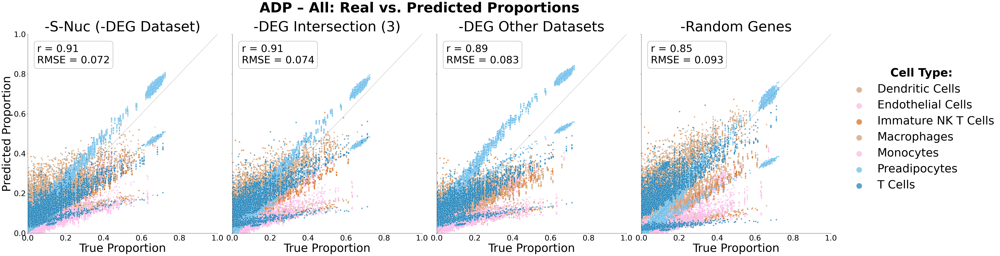

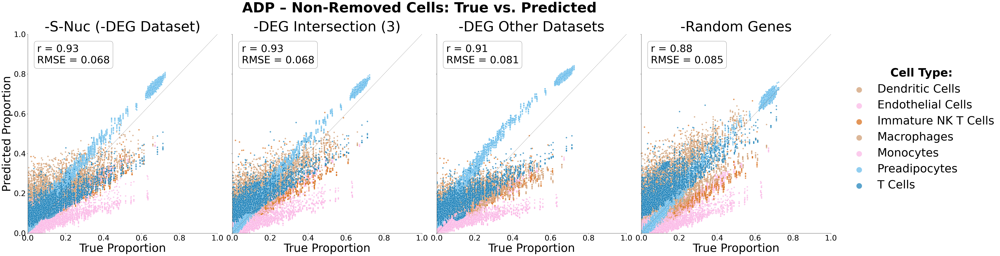

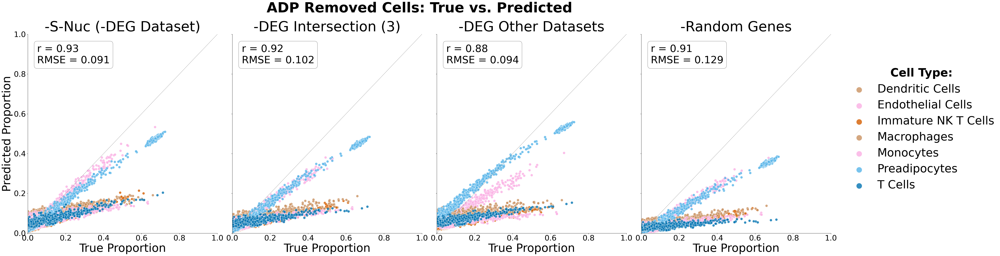

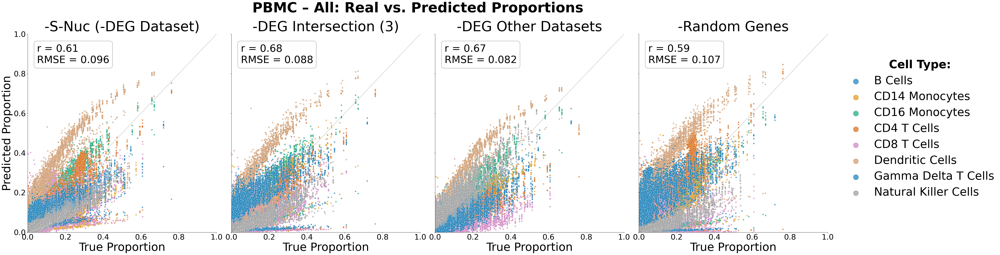

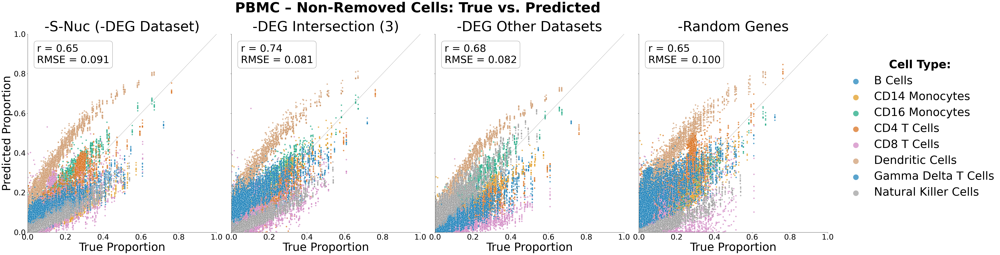

...

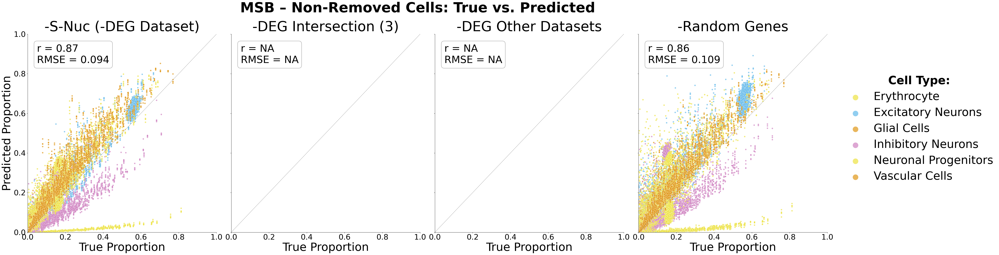

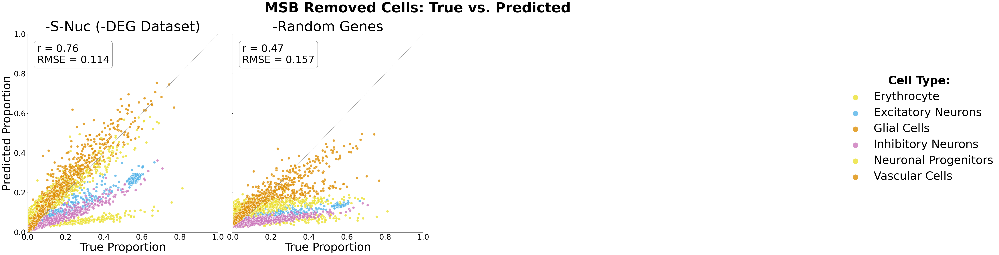

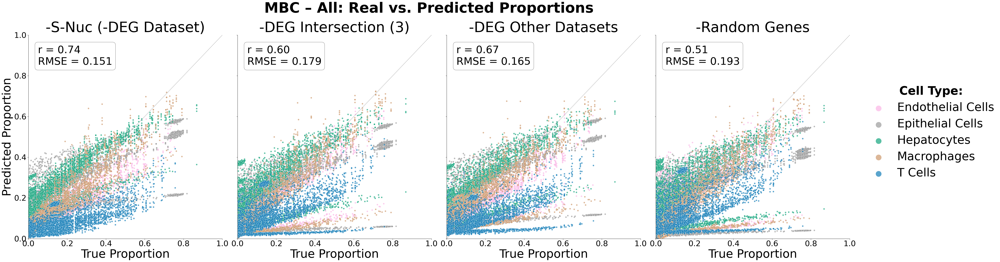

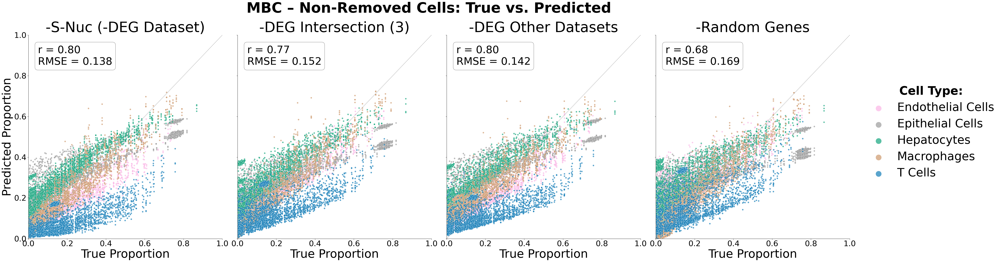

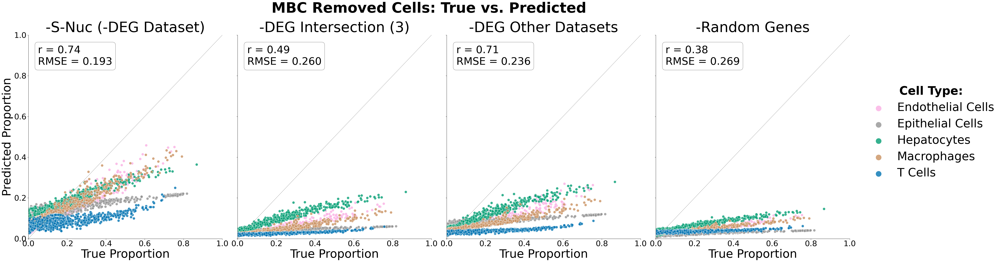

In [40]:
col_wrap = 5 if baseline_transforms else 4
for ds in datasets:
    for scenario in ["all", "non_removed", "removed"]:
        plot_proportions(
            results,
            ds,
            scenario,
            transform_mapping,
            display_order,
            dataset_cell_info,
            baseline_transforms,
            fig_x,
            fig_y,
        )

In [41]:
# Display the first few rows of each for inspection
print("All Cells Metrics:")
print(all_cells_df.head())

print("\nAll Cells Except Held Out Metrics:")
print(non_removed_df.head())

print("\nRemoved Cell Only Metrics:")
print(removed_only_df.head())

All Cells Metrics:
  Dataset SampleID Transform          RemovedCell  RMSE_All  Pearson_All
0     ADP        1  degIntSN      Dendritic Cells  0.099905     0.796503
1     ADP        1  degIntSN    Endothelial Cells  0.103987     0.782195
2     ADP        1  degIntSN  Immature NK T Cells  0.186417     0.055594
3     ADP        1  degIntSN          Macrophages  0.116209     0.698782
4     ADP        1  degIntSN            Monocytes  0.104477     0.790569

All Cells Except Held Out Metrics:
  Dataset SampleID Transform          RemovedCell  RMSE_NonRemoved  \
0     ADP        1  degIntSN      Dendritic Cells         0.107022   
1     ADP        1  degIntSN    Endothelial Cells         0.112164   
2     ADP        1  degIntSN  Immature NK T Cells         0.130185   
3     ADP        1  degIntSN          Macrophages         0.120371   
4     ADP        1  degIntSN            Monocytes         0.112553   

   Pearson_NonRemoved  
0            0.777877  
1            0.783395  
2            0

Saving for later use:

In [ ]:
if baseline_transforms:
    for ds in datasets:
        ds_rem = removed_only_df[removed_only_df.Dataset == ds].copy()
        ds_nonrem = non_removed_df[non_removed_df.Dataset == ds].copy()
        path = os.path.join(base_dir, "results", ds)
        ds_rem.to_csv(f"{path}/removed_only_results_baseline.csv")
        ds_nonrem.to_csv(f"{path}/nonremoved_only_results_baseline.csv")
else:
    for ds in datasets:
        ds_rem = removed_only_df[removed_only_df.Dataset == ds].copy()
        ds_nonrem = non_removed_df[non_removed_df.Dataset == ds].copy()
        path = os.path.join(base_dir, "results", ds)
        ds_rem.to_csv(f"{path}/removed_only_results_degs.csv")
        ds_nonrem.to_csv(f"{path}/nonremoved_only_results_degs.csv")

Boostrap 95% CI

In [ ]:
if baseline_transforms:
    fig_bs_x = 32
    fig_bs_y = 28
    fig_bs_x_MSB = fig_bs_x
    fig_bs_y_MSB = fig_bs_y
else:
    fig_bs_x = 24
    fig_bs_y = 28
    fig_bs_x_MSB = 22
    fig_bs_y_MSB = 28

In [ ]:
def bootstrap_mean_ci(values, n_boot=5000, alpha=0.05, random_state=None):
    """
    Compute the mean and 95% bootstrap confidence interval (CI) of the mean.
    If all values are constant (as for controls), return that constant and CI equal to that value.
    """
    arr = pd.Series(values).dropna().values
    rng = np.random.default_rng(random_state)
    means = []
    for _ in range(n_boot):
        sample = rng.choice(arr, size=len(arr), replace=True)
        means.append(sample.mean())
    means = np.array(means)
    lower = np.percentile(means, 100 * (alpha / 2.0))
    upper = np.percentile(means, 100 * (1 - alpha / 2.0))
    return pd.Series({"mean": arr.mean(), "ci_lower": lower, "ci_upper": upper})

In [ ]:
# Precomputed figure sizes
fig_sizes = {"default": (fig_bs_x, fig_bs_y), "MSB": (fig_bs_x_MSB, fig_bs_y_MSB)}

In [ ]:
# Helper: pick mapping, order, and palette per dataset
def get_dataset_settings(ds):
    if baseline_transforms:
        return transform_mapping, display_order, display_palette
    if ds == "MSB":
        return transform_mapping_MSB, display_order_MSB, display_palette_MSB
    return transform_mapping, display_order, display_palette

In [ ]:
# Helper: aggregate mean & CI with bootstrap, ordering by 'order'
def aggregate_bootstrap(data, metric, order):
    # metric e.g. 'Pearson_NonRemoved'
    long = (
        data.groupby("DisplayTransform", observed=False)[metric]
        .apply(lambda x: bootstrap_mean_ci(x))
        .apply(pd.Series)
        .reset_index()
    )
    wide = long.pivot(index="DisplayTransform", columns="level_1", values=0)
    wide.columns.name = None
    wide = wide.rename(
        columns={
            "mean": f"{metric}_mean",
            "ci_lower": f"{metric}_ci_lower",
            "ci_upper": f"{metric}_ci_upper",
        }
    )
    # Reindex to ensure transforms appear in the correct display order
    return wide.reindex([t for t in order if t in wide.index])

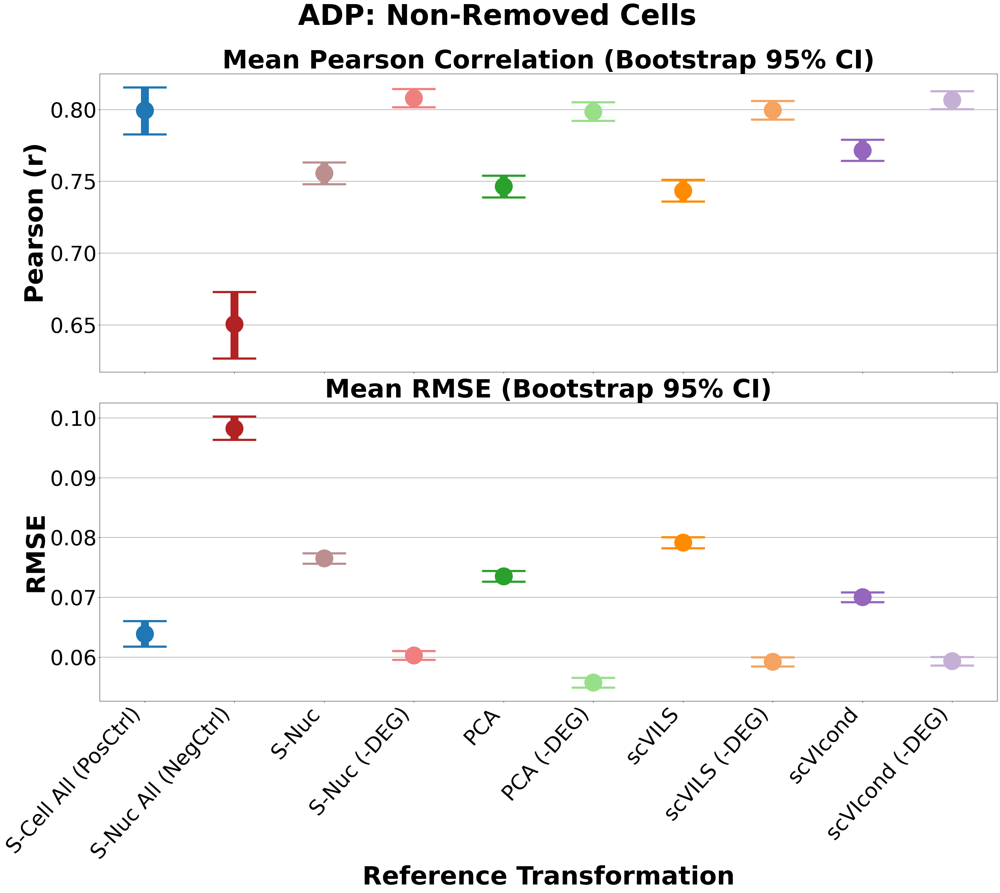

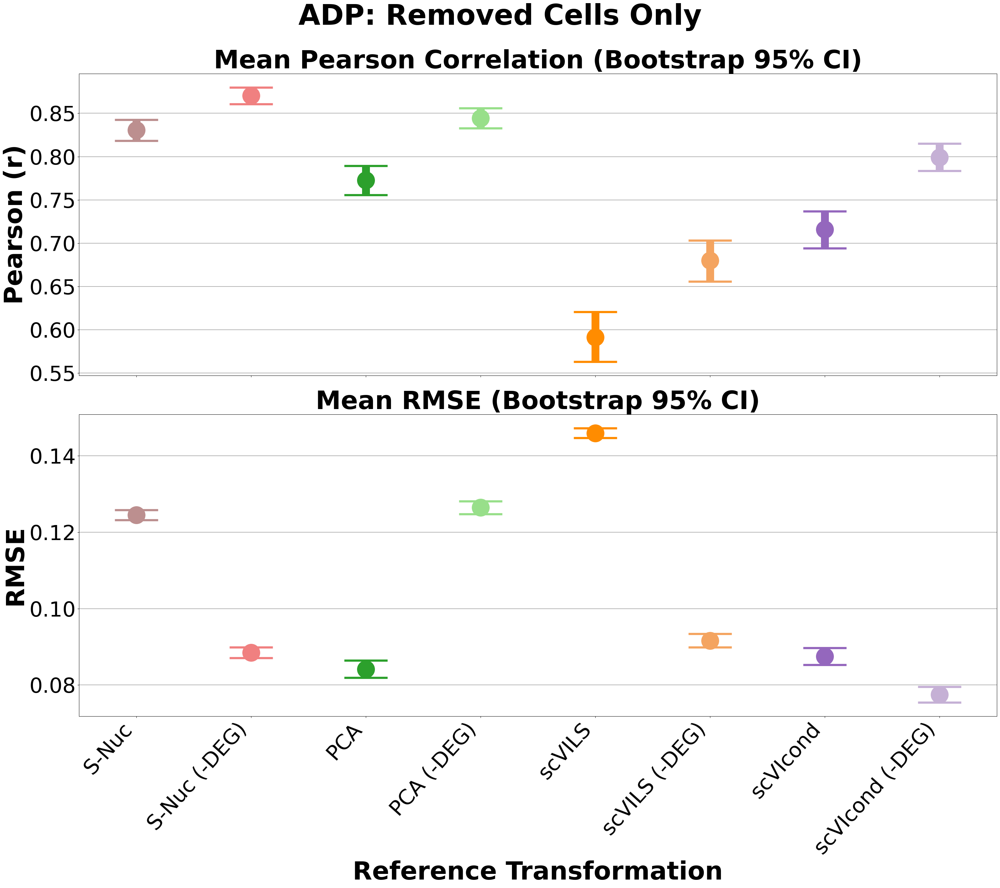

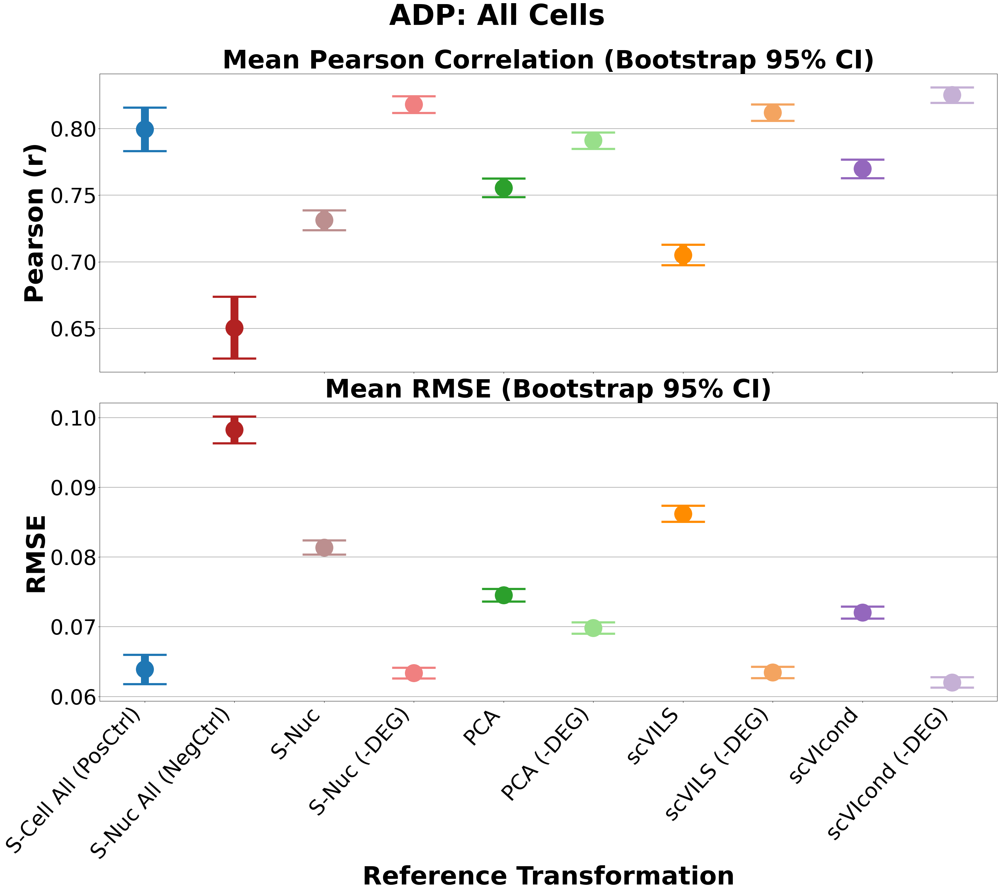

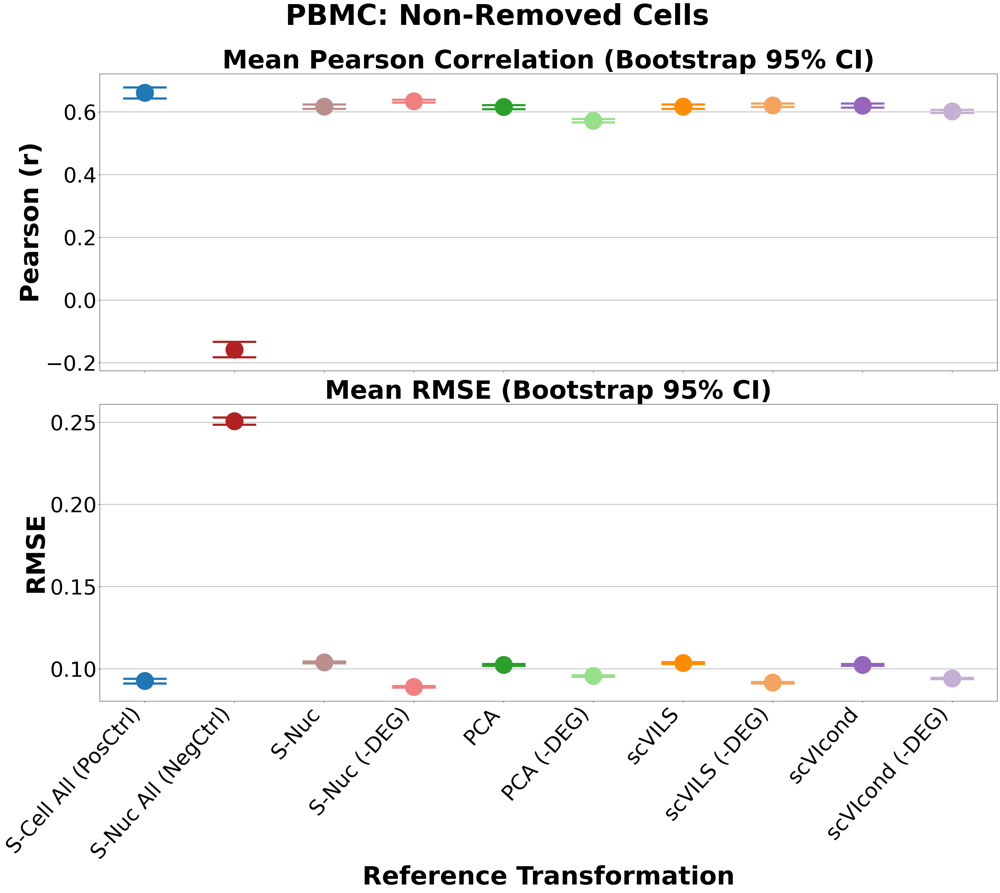

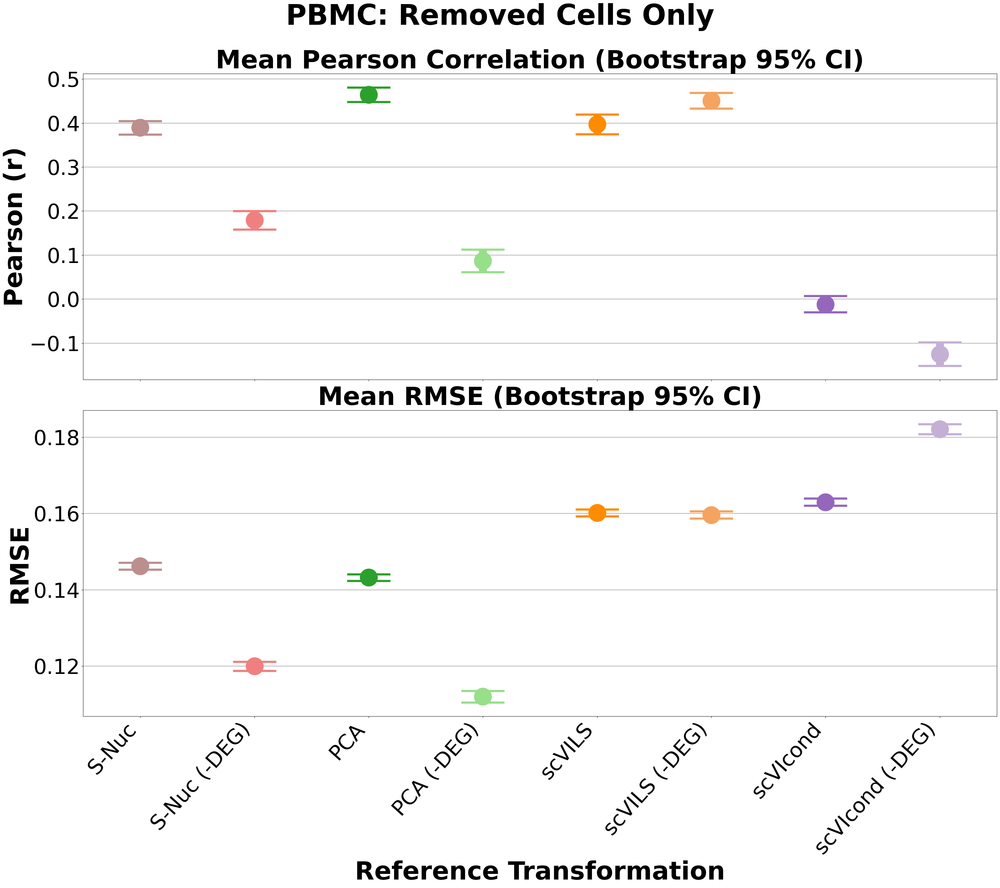

...

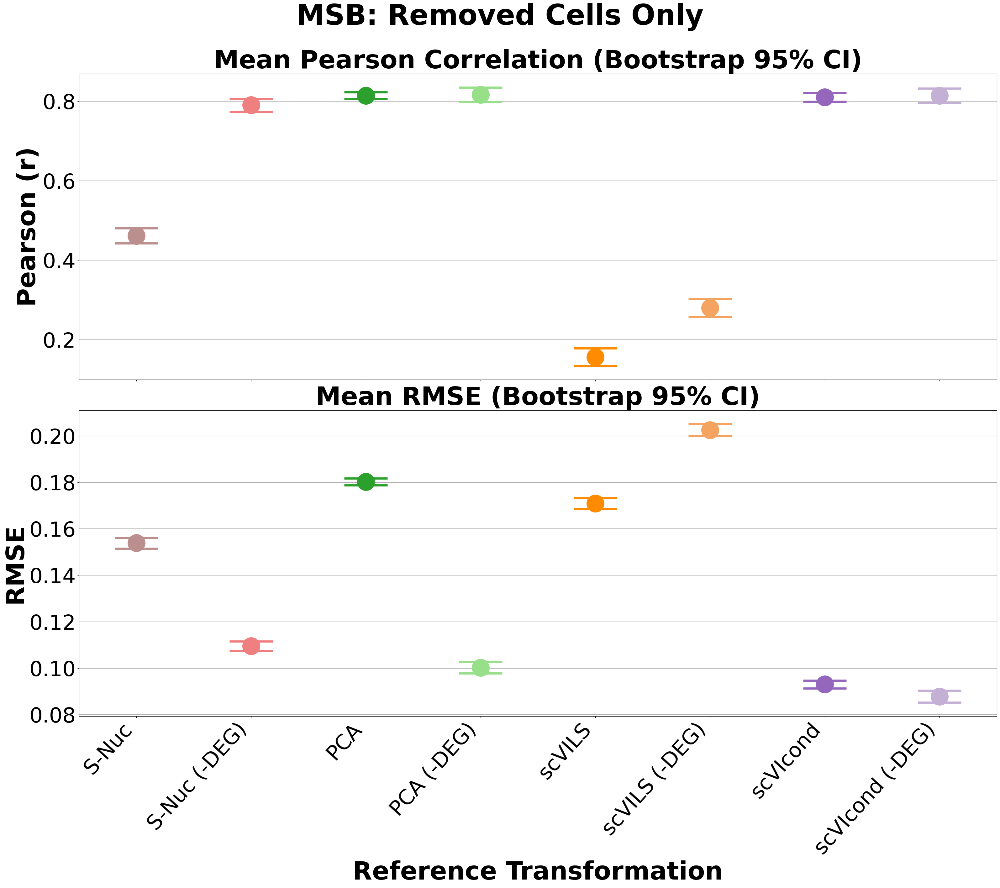

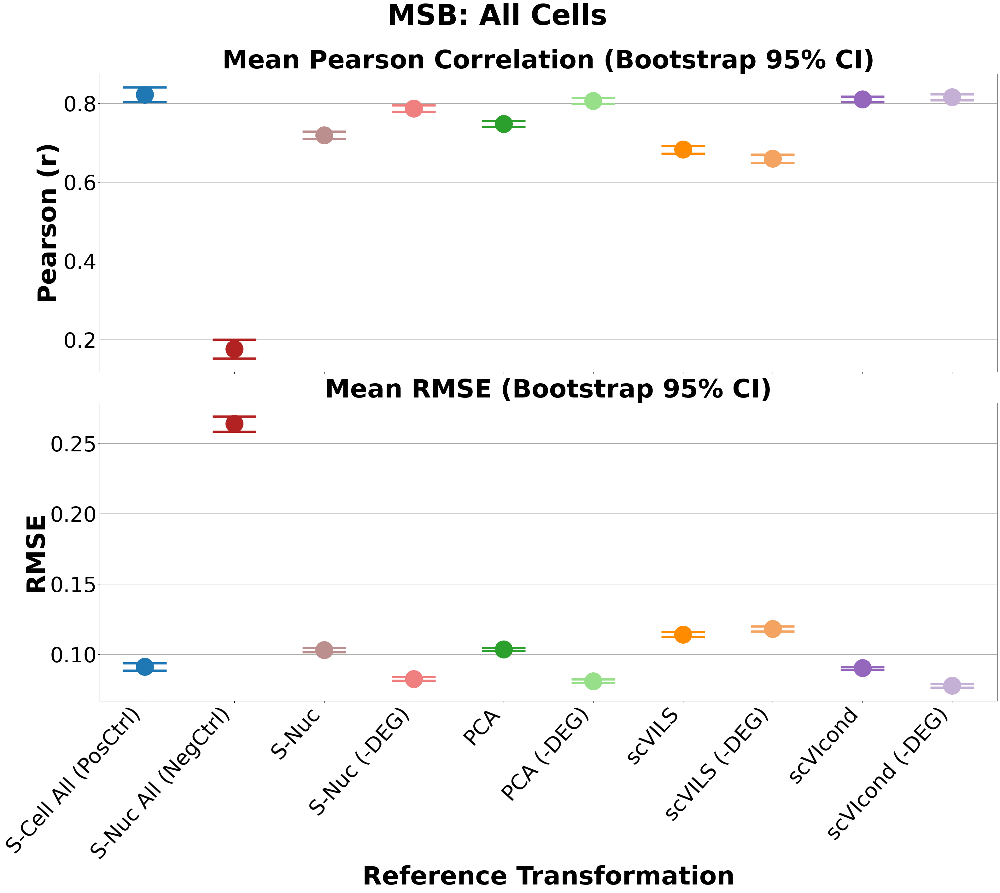

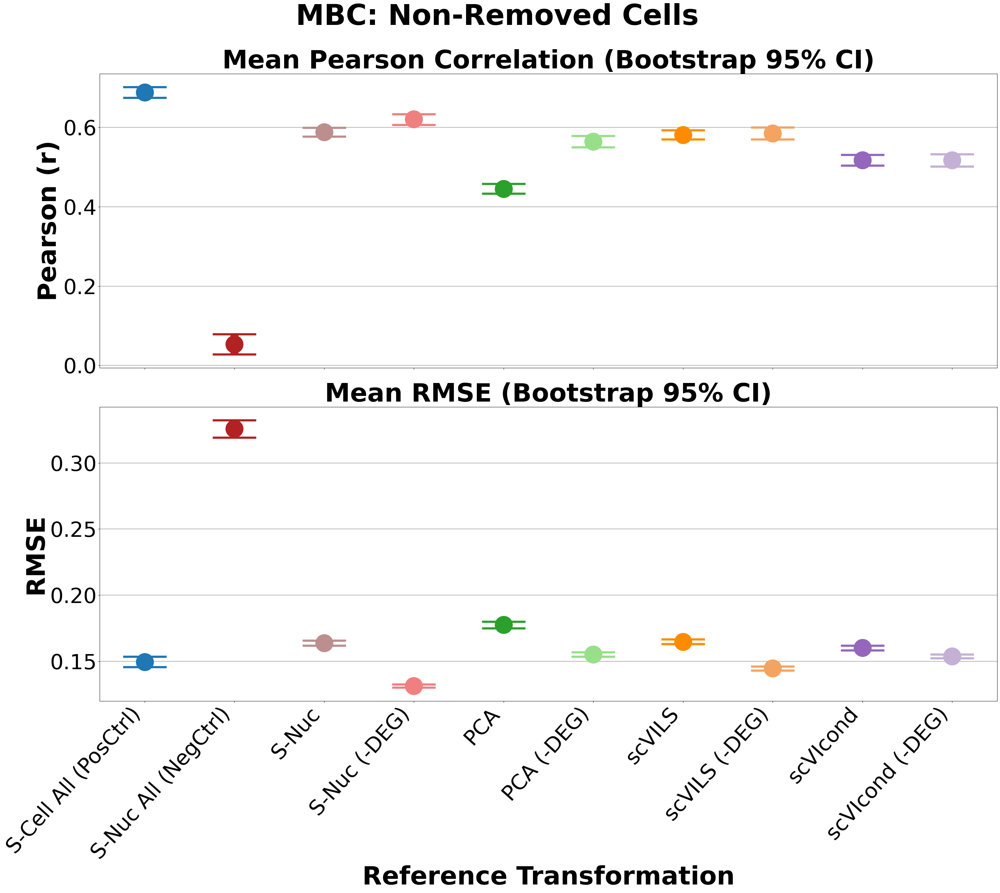

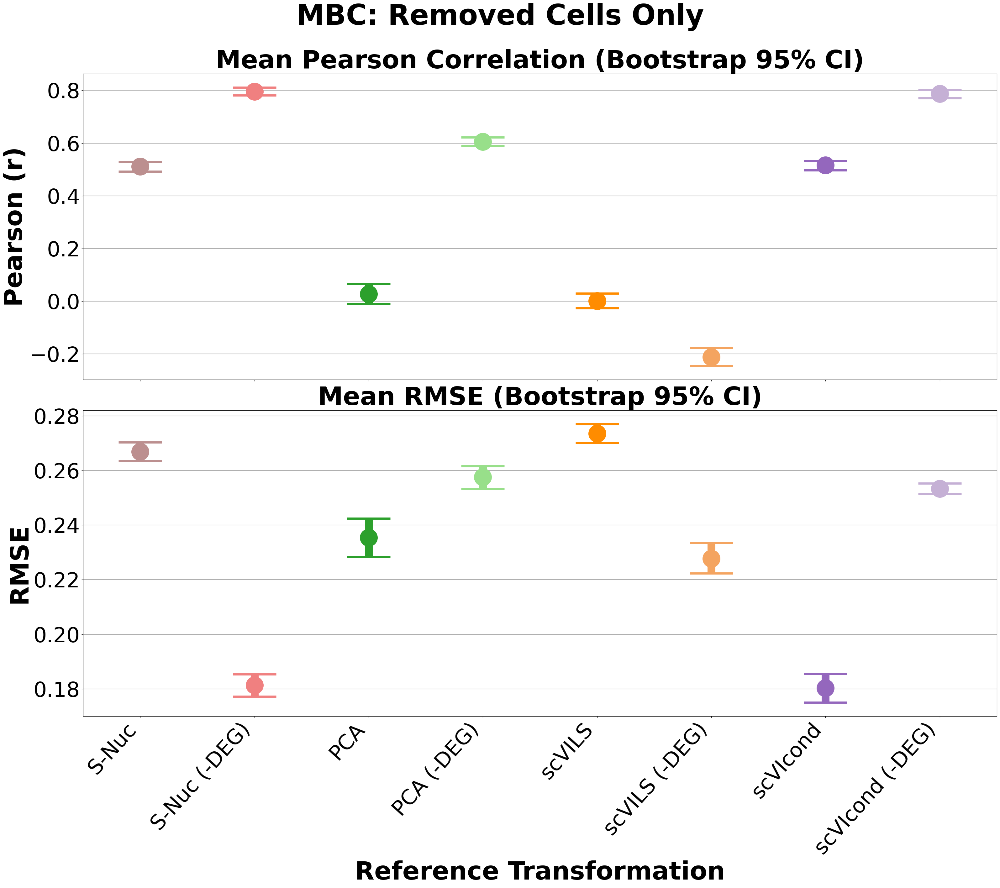

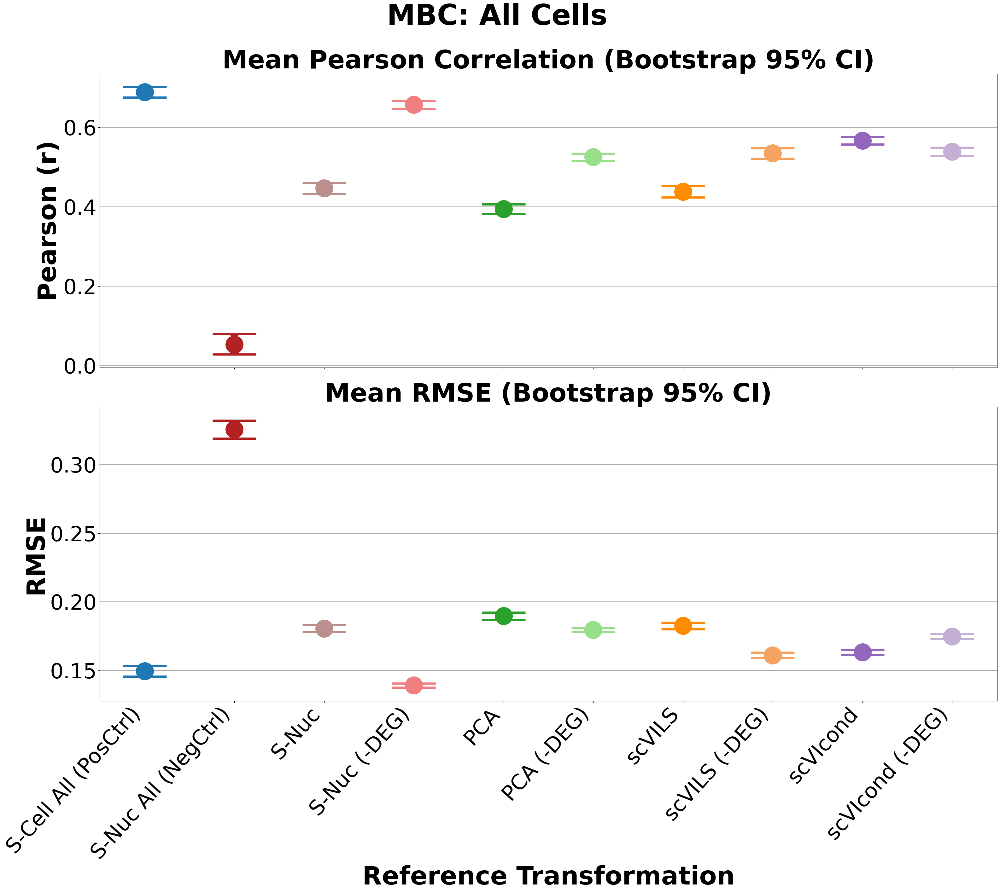

In [ ]:
# Main plotting function
def plot_bootstrap_metrics(ds, df_input, prefixes, title_label):
    # 1) Get mapping, order, and palette
    mapping, order, palette = get_dataset_settings(ds)

    # 2) Prepare DataFrame
    df = df_input.copy()
    df["DisplayTransform"] = df["Transform"].map(mapping)
    df = df[df["Dataset"] == ds]

    # 3) Aggregate metrics
    agg1 = aggregate_bootstrap(df, prefixes[0], order)
    agg2 = aggregate_bootstrap(df, prefixes[1], order)
    agg = agg1.join(agg2, how="outer")

    # 4) Drop transforms without the first metric, then reindex to enforce order
    agg = agg.dropna(subset=[f"{prefixes[0]}_mean"]).reindex(
        [t for t in order if t in agg.index]
    )

    # 5) Plot setup
    x = np.arange(len(agg))
    fig_w, fig_h = fig_sizes.get(ds, fig_sizes["default"])
    fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(fig_w, fig_h))
    fig.suptitle(f"{ds}: {title_label}", fontsize=65, fontweight="bold", y=1.01)

    # 6) Draw error bars for each metric
    for ax, metric in zip((ax1, ax2), prefixes):
        for i, trans in enumerate(agg.index):
            mean = agg.at[trans, f"{metric}_mean"]
            low = agg.at[trans, f"{metric}_ci_lower"]
            high = agg.at[trans, f"{metric}_ci_upper"]
            if pd.isna(mean):
                continue
            yerr = [[mean - low], [high - mean]]
            ax.errorbar(
                x[i],
                mean,
                yerr=yerr,
                fmt="o",
                color=palette.get(trans, "gray"),
                capsize=50,
                markersize=40,
                lw=18,
                elinewidth=18,
                capthick=5,
            )

    # 7) Styling
    ax1.set_title(
        "Mean Pearson Correlation (Bootstrap 95% CI)", fontsize=58, fontweight="bold"
    )
    ax2.set_title("Mean RMSE (Bootstrap 95% CI)", fontsize=58, fontweight="bold")
    ax1.set_ylabel("Pearson (r)", fontsize=58, fontweight="bold")
    ax2.set_ylabel("RMSE", fontsize=58, fontweight="bold")
    ax2.set_xlabel("Reference Transformation", fontsize=58, fontweight="bold")

    for ax in (ax1, ax2):
        ax.tick_params(axis="both", labelsize=48)
        ax.grid(axis="y", which="major", linewidth=1.5)
        # enforce x-limits tightly around the plotted points
        ax.set_xlim(-0.5, len(agg) - 0.5)

    # 8) X-axis labels only on bottom plot
    ax2.set_xticks(x)
    ax2.set_xticklabels(agg.index, rotation=48, ha="right", fontsize=48)

    plt.tight_layout()
    plt.show()

In [ ]:
scenarios = [
    ("Non-Removed Cells", non_removed_df, ["Pearson_NonRemoved", "RMSE_NonRemoved"]),
    (
        "Removed Cells Only",
        removed_only_df,
        ["Pearson_RemovedOnly", "RMSE_RemovedOnly"],
    ),
    ("All Cells", all_cells_df, ["Pearson_All", "RMSE_All"]),
]
for ds in datasets:
    for label, df_in, metrics in scenarios:
        plot_bootstrap_metrics(ds, df_in, metrics, label)

## Evaluation of the References

In [ ]:
########################
# 1) Helper Functions
########################
def bootstrap_mean_ci(values, n_boot=5000, alpha=0.05, random_state=None):
    """
    Compute the mean and (1 - alpha)*100% bootstrap confidence interval (CI) of the mean.
    If all values are constant, returns the constant and CI=that constant.
    """
    arr = pd.Series(values).dropna().values
    if len(arr) == 0:
        return pd.Series({"mean": np.nan, "ci_lower": np.nan, "ci_upper": np.nan})
    if np.allclose(arr, arr[0]):
        # All values are the same
        return pd.Series({"mean": arr[0], "ci_lower": arr[0], "ci_upper": arr[0]})

    rng = np.random.default_rng(random_state)
    means = []
    for _ in range(n_boot):
        sample = rng.choice(arr, size=len(arr), replace=True)
        means.append(sample.mean())
    means = np.array(means)
    lower = np.percentile(means, 100 * (alpha / 2.0))
    upper = np.percentile(means, 100 * (1 - alpha / 2.0))
    return pd.Series({"mean": arr.mean(), "ci_lower": lower, "ci_upper": upper})


def plot_scenario_bootstrap(df_plot, scenario_label, metric_cols=("Pearson", "RMSE")):
    """
    df_plot: DataFrame with columns:
       - 'Transform'
       - f'{metric_cols[0]}'
       - f'{metric_cols[1]}'
    scenario_label: str, name of the scenario (e.g. "All Cells", "Non-Removed Cells", "Removed Cells Only")
    metric_cols: tuple of the prefix for the metrics columns in df (Pearson, RMSE).
                 We'll expect df to have columns named e.g. {Pearson}_mean, {Pearson}_ci_lower, etc. after grouping.

    This function:
      1) Maps raw 'Transform' to display name
      2) Groups by 'DisplayTransform'
      3) bootstrap Mean + CI for each of the 2 metrics
      4) Plots them with error bars in separate subplots
    """

    # 1) Map transformations
    df_plot["DisplayTransform"] = df_plot["Transform"].map(transform_mapping)

    # 2) Group + bootstrap for the 2 metrics
    # e.g. we have 'Pearson_All' or 'Pearson_NonRemoved' etc.
    pearson_col = f"{metric_cols[0]}"
    rmse_col = f"{metric_cols[1]}"

    # A) Pearson aggregator
    pearson_long = (
        df_plot.groupby("DisplayTransform", observed=False)[pearson_col]
        .apply(lambda x: bootstrap_mean_ci(x))
        .apply(pd.Series)
        .reset_index()
    )
    # pivot
    pearson_wide = pearson_long.pivot(
        index="DisplayTransform", columns="level_1", values=0
    ).reset_index()
    pearson_wide.columns.name = None
    pearson_wide.rename(
        columns={
            "mean": f"{pearson_col}_mean",
            "ci_lower": f"{pearson_col}_ci_lower",
            "ci_upper": f"{pearson_col}_ci_upper",
        },
        inplace=True,
    )

    # B) RMSE aggregator
    rmse_long = (
        df_plot.groupby("DisplayTransform", observed=False)[rmse_col]
        .apply(lambda x: bootstrap_mean_ci(x))
        .apply(pd.Series)
        .reset_index()
    )
    rmse_wide = rmse_long.pivot(
        index="DisplayTransform", columns="level_1", values=0
    ).reset_index()
    rmse_wide.columns.name = None
    rmse_wide.rename(
        columns={
            "mean": f"{rmse_col}_mean",
            "ci_lower": f"{rmse_col}_ci_lower",
            "ci_upper": f"{rmse_col}_ci_upper",
        },
        inplace=True,
    )

    # Merge
    agg = pd.merge(pearson_wide, rmse_wide, on="DisplayTransform", how="outer")
    agg["DisplayTransform"] = agg["DisplayTransform"].astype(str)
    agg.set_index("DisplayTransform", inplace=True)

    # Reindex
    display_order_str = list(dict.fromkeys(str(x) for x in display_order))
    agg = agg.reindex(display_order_str)

    # Drop rows if there's no data
    agg.dropna(
        subset=[f"{pearson_col}_mean", f"{rmse_col}_mean"], how="all", inplace=True
    )

    # Plot
    x = np.arange(len(agg))
    fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(fig_bs_x, fig_bs_y))
    fig.suptitle(
        f"{scenario_label}:\nReal vs. Deconv. Predicted Proportions",
        fontsize=75,
        fontweight="bold",
        y=1.01,
        x=0.5,
    )

    # Plot Pearson
    for i, trans in enumerate(agg.index):
        row = agg.loc[trans]
        mean_val = row[f"{pearson_col}_mean"]
        if pd.isna(mean_val):
            continue
        lower_val = row[f"{pearson_col}_ci_lower"]
        upper_val = row[f"{pearson_col}_ci_upper"]
        if pd.isna(lower_val) or pd.isna(upper_val):
            continue
        yerr = [[mean_val - lower_val], [upper_val - mean_val]]
        color = display_palette.get(trans, "gray")
        ax1.errorbar(
            x[i],
            mean_val,
            yerr=yerr,
            fmt="o",
            color=color,
            capsize=50,
            markersize=40,
            lw=18,
            elinewidth=18,
            capthick=5,
        )
    ax1.set_title(
        f"Mean Pearson Correlation (Bootstrap 95% CI)", fontsize=68, x=0.42, y=1.1
    )
    ax1.set_ylabel("Pearson r", fontsize=58, fontweight="bold")
    ax1.set_ylim([0.15, 0.8])
    ax1.tick_params(axis="both", labelsize=58)
    ax1.grid(axis="y", which="major", linewidth=1.5)

    # Plot RMSE
    for i, trans in enumerate(agg.index):
        row = agg.loc[trans]
        mean_val = row[f"{rmse_col}_mean"]
        if pd.isna(mean_val):
            continue
        lower_val = row[f"{rmse_col}_ci_lower"]
        upper_val = row[f"{rmse_col}_ci_upper"]
        if pd.isna(lower_val) or pd.isna(upper_val):
            continue
        yerr = [[mean_val - lower_val], [upper_val - mean_val]]
        color = display_palette.get(trans, "gray")
        ax2.errorbar(
            x[i],
            mean_val,
            yerr=yerr,
            fmt="o",
            color=color,
            capsize=50,
            markersize=40,
            lw=18,
            elinewidth=18,
            capthick=5,
        )
    ax2.set_title(f"Mean RMSE (Bootstrap 95% CI)", fontsize=68, x=0.42, y=1.1)
    ax2.set_ylabel("RMSE", fontsize=58, fontweight="bold")
    ax2.set_xlabel("Reference Transformation", fontsize=58, fontweight="bold")
    ax2.tick_params(axis="both", labelsize=48)
    ax2.set_xticks(x)
    ax2.set_xticklabels(agg.index, rotation=52, ha="right", fontsize=54)
    ax2.grid(axis="y", which="major", linewidth=1.5)
    ax2.set_ylim([0.08, 0.29])
    plt.tight_layout()
    plt.show()

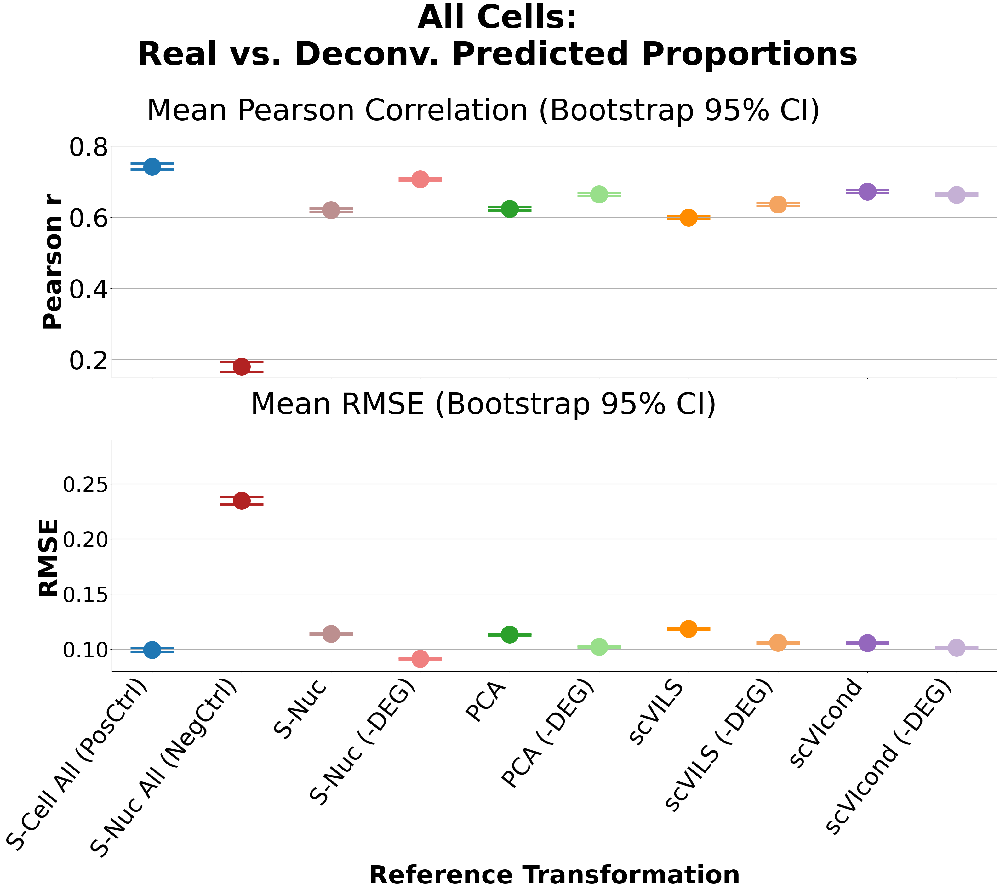

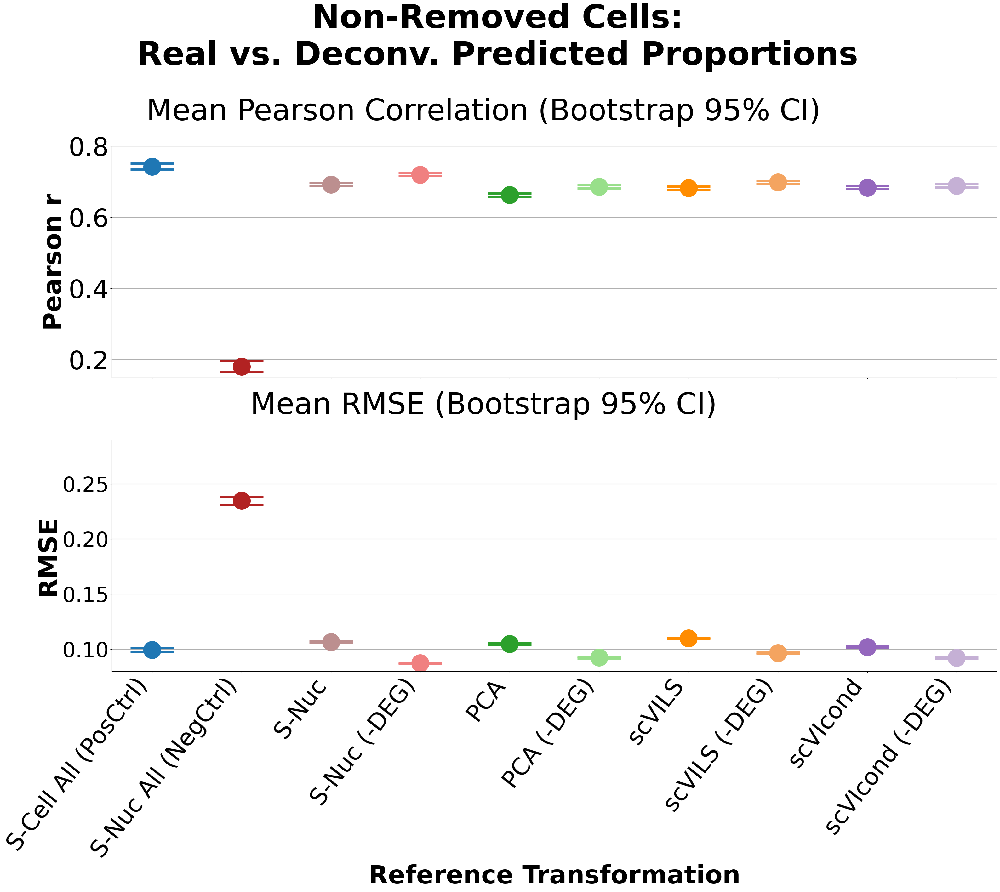

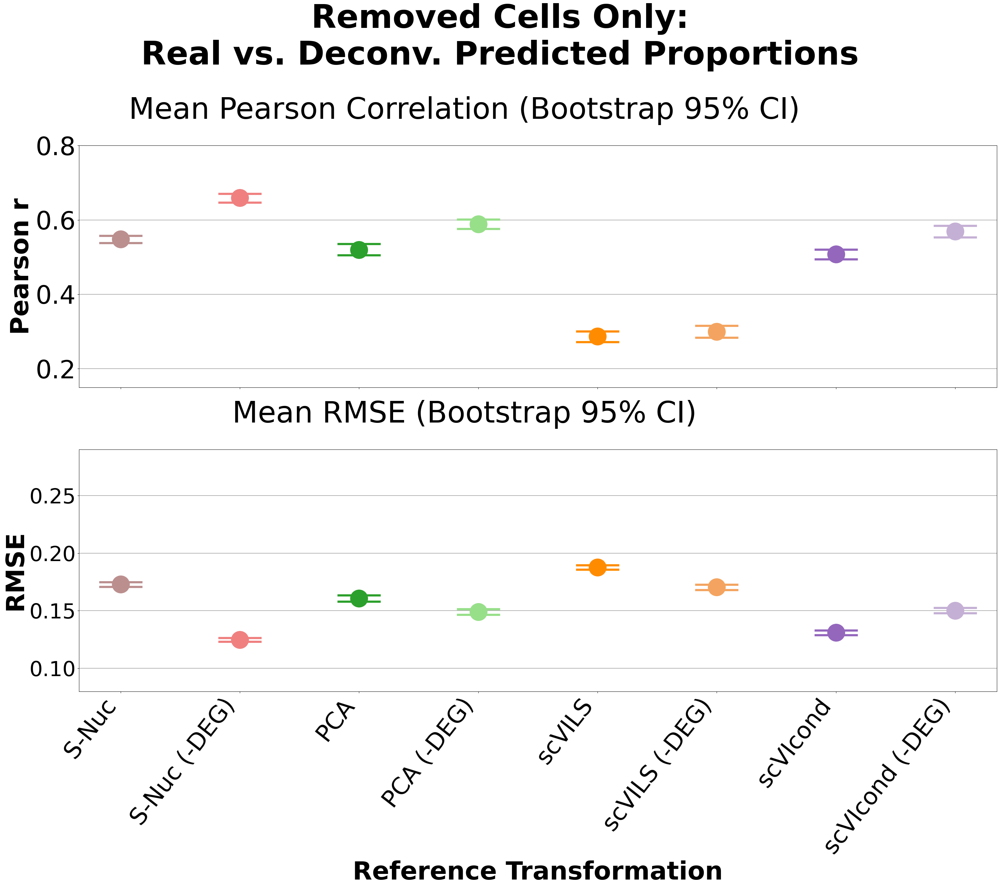

In [ ]:
# 4a) All Cells
# -------------
# all_cells_df includes data from ALL datasets in one combined DataFrame
df_all_cells = (
    all_cells_df.copy()
)  # Make sure it has 'Transform','Pearson_All','RMSE_All'
plot_scenario_bootstrap(
    df_plot=df_all_cells,
    scenario_label="All Cells",
    metric_cols=("Pearson_All", "RMSE_All"),
)

# 4b) Non-Removed Cells
# ---------------------
df_non_removed_agg = non_removed_df.copy()  # Combined across all datasets
plot_scenario_bootstrap(
    df_plot=df_non_removed_agg,
    scenario_label="Non-Removed Cells",
    metric_cols=("Pearson_NonRemoved", "RMSE_NonRemoved"),
)

# 4c) Removed Cells Only
# ----------------------
df_removed_only_agg = removed_only_df.copy()  # Combined across all datasets
plot_scenario_bootstrap(
    df_plot=df_removed_only_agg,
    scenario_label="Removed Cells Only",
    metric_cols=("Pearson_RemovedOnly", "RMSE_RemovedOnly"),
)

/projects/aivich@xsede.org/code-server/tmp/ipykernel_1921689/2322800150.py:141: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0,0.06,1,0.96])


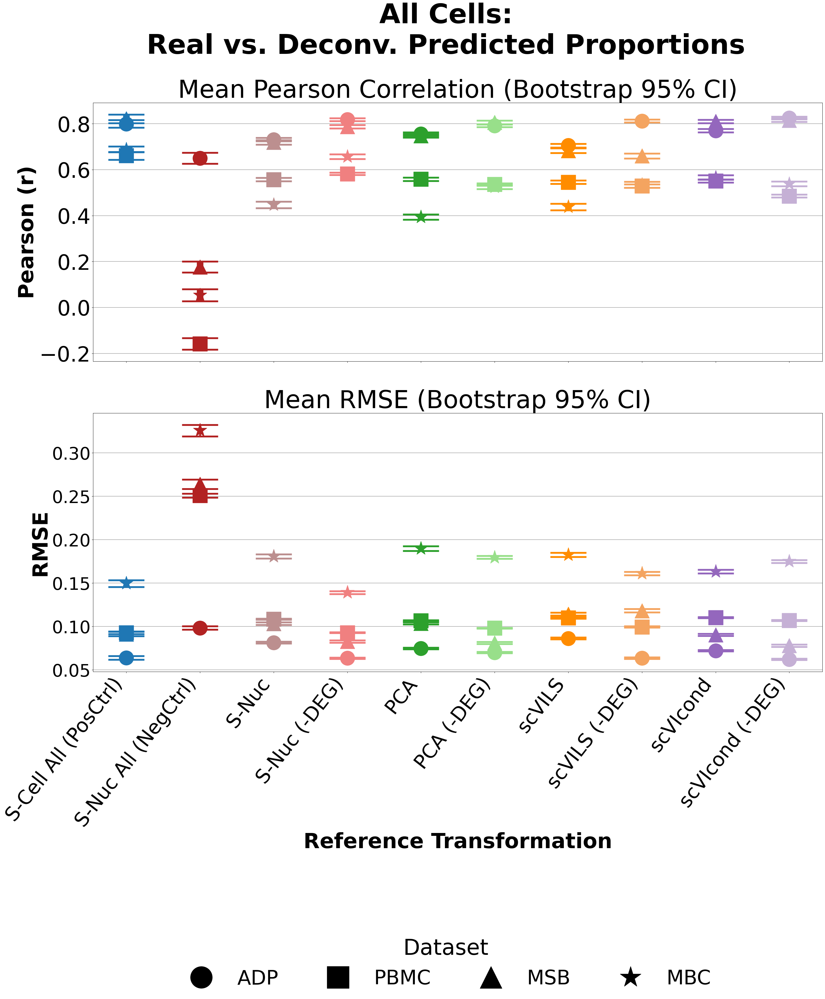

/projects/aivich@xsede.org/code-server/tmp/ipykernel_1921689/2322800150.py:141: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0,0.06,1,0.96])


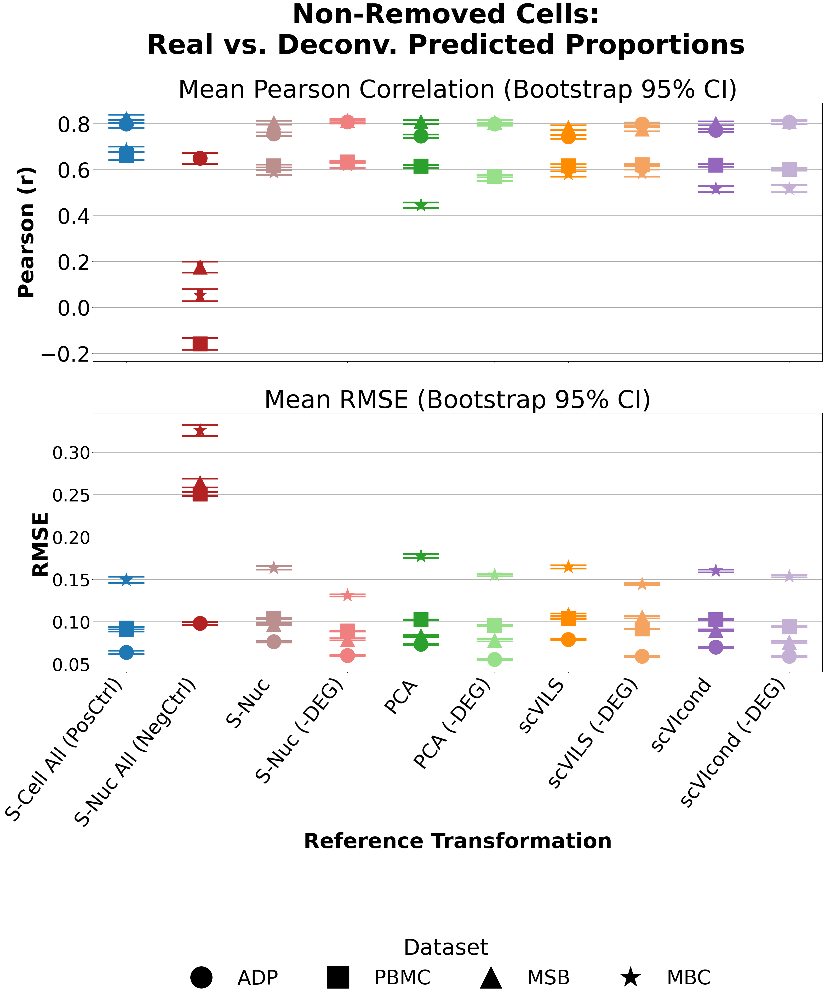

/projects/aivich@xsede.org/code-server/tmp/ipykernel_1921689/2322800150.py:141: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0,0.06,1,0.96])


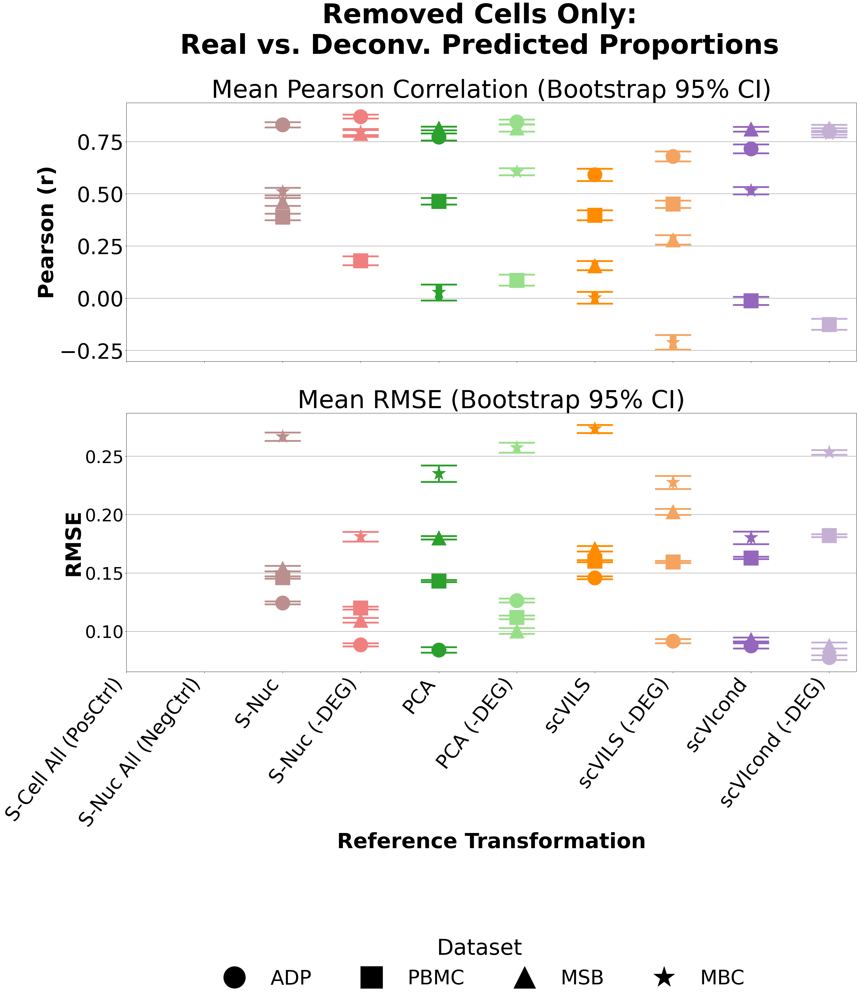

In [ ]:
def plot_scenario_bootstrap_multi_ds(
    df_plot,
    scenario_label,
    metric_cols=("Pearson", "RMSE"),
    display_palette=display_palette,
    desired_order=display_order,
    fig_bs_x=36,
    fig_bs_y=32,
):
    """
    Like plot_scenario_bootstrap, but plots each of the 4 datasets
    with its own marker, colored by transform.
    df_plot must have columns:
      - 'Dataset'
      - 'Transform'
      - f'{metric_cols[0]}' e.g. 'Pearson_All'
      - f'{metric_cols[1]}' e.g. 'RMSE_All'
    """

    pearson_col, rmse_col = metric_cols

    # 1) bootstrap per (Dataset, Transform)
    records = []
    for (ds, trans), grp in df_plot.groupby(["Dataset", "Transform"], observed=False):
        vals_p = grp[pearson_col].dropna().values
        vals_r = grp[rmse_col].dropna().values
        if len(vals_p) == 0 or len(vals_r) == 0:
            continue
        bs_p = bootstrap_mean_ci(vals_p, random_state=0)
        bs_r = bootstrap_mean_ci(vals_r, random_state=0)
        records.append(
            {
                "Dataset": ds,
                "Transform": trans,
                "p_mean": bs_p["mean"],
                "p_lo": bs_p["ci_lower"],
                "p_hi": bs_p["ci_upper"],
                "r_mean": bs_r["mean"],
                "r_lo": bs_r["ci_lower"],
                "r_hi": bs_r["ci_upper"],
            }
        )
    bs_df = pd.DataFrame(records)
    bs_df["DisplayTrans"] = bs_df["Transform"].map(transform_mapping)

    # reorder x
    x = np.arange(len(desired_order))

    fig, (ax1, ax2) = plt.subplots(
        2,
        1,
        sharex=True,
        figsize=(fig_bs_x, fig_bs_y),
        gridspec_kw={"height_ratios": [1, 1], "bottom": 0.2},
    )
    fig.suptitle(
        f"{scenario_label}:\nReal vs. Deconv. Predicted Proportions",
        fontsize=75,
        fontweight="bold",
        y=1,
    )

    # top: Pearson
    for ds, marker in dataset_markers.items():
        sub = (
            bs_df[bs_df.Dataset == ds].set_index("DisplayTrans").reindex(desired_order)
        )
        means = sub["p_mean"].values
        lo = sub["p_lo"].values
        hi = sub["p_hi"].values
        for i, trans in enumerate(desired_order):
            if np.isnan(means[i]):
                continue
            err = [[means[i] - lo[i]], [hi[i] - means[i]]]
            ax1.errorbar(
                x[i],
                means[i],
                yerr=err,
                fmt=marker,
                markersize=40,
                color=display_palette[trans],
                capsize=50,
                lw=18,
                elinewidth=18,
                capthick=5,
            )
    ax1.set_title("Mean Pearson Correlation (Bootstrap 95% CI)", fontsize=68)
    ax1.set_ylabel("Pearson (r)", fontsize=58, fontweight="bold")
    # ax1.set_ylim([0.15,0.8])
    ax1.tick_params(axis="both", labelsize=58)
    ax1.grid(axis="y", which="major", linewidth=1.5)

    # bottom: RMSE
    for ds, marker in dataset_markers.items():
        sub = (
            bs_df[bs_df.Dataset == ds].set_index("DisplayTrans").reindex(desired_order)
        )
        means = sub["r_mean"].values
        lo = sub["r_lo"].values
        hi = sub["r_hi"].values
        for i, trans in enumerate(desired_order):
            if np.isnan(means[i]):
                continue
            err = [[means[i] - lo[i]], [hi[i] - means[i]]]
            ax2.errorbar(
                x[i],
                means[i],
                yerr=err,
                fmt=marker,
                markersize=40,
                color=display_palette[trans],
                capsize=50,
                lw=18,
                elinewidth=5,
                capthick=5,
            )
    ax2.set_title("Mean RMSE (Bootstrap 95% CI)", fontsize=68, pad=0.05)
    ax2.set_ylabel("RMSE", fontsize=58, fontweight="bold")
    ax2.set_xlabel("Reference Transformation", fontsize=58, fontweight="bold")
    ax2.tick_params(axis="both", labelsize=48)
    ax2.set_xticks(x)
    ax2.set_xticklabels(desired_order, rotation=52, ha="right", fontsize=54)
    # ax2.set_ylim([0.08,0.29])
    ax2.grid(axis="y", which="major", linewidth=1.5)

    # one legend below
    # create dummy handles
    handles = []
    labels = []
    for ds, marker in dataset_markers.items():
        h = mlines.Line2D(
            [], [], marker=marker, linestyle="None", color="black", markersize=15
        )
        handles.append(h)
        labels.append(ds)
    fig.legend(
        handles,
        labels,
        title="Dataset",
        ncol=len(dataset_markers),
        bbox_to_anchor=(0.5, -0.2),
        loc="lower center",
        fontsize=55,
        title_fontsize=60,
        frameon=False,
        markerscale=4,
    )

    plt.tight_layout(rect=[0, 0.06, 1, 0.96])
    for ax in (ax1, ax2):
        ax.margins(x=0.2)
    plt.show()

# All Cells
plot_scenario_bootstrap_multi_ds(
    df_plot=all_cells_df,
    scenario_label="All Cells",
    metric_cols=("Pearson_All", "RMSE_All"),
)

# Non-Removed Cells
plot_scenario_bootstrap_multi_ds(
    df_plot=non_removed_df,
    scenario_label="Non-Removed Cells",
    metric_cols=("Pearson_NonRemoved", "RMSE_NonRemoved"),
)

# Removed Cells Only
plot_scenario_bootstrap_multi_ds(
    df_plot=removed_only_df,
    scenario_label="Removed Cells Only",
    metric_cols=("Pearson_RemovedOnly", "RMSE_RemovedOnly"),
)